# King Tutte Codex: plot_interactive_cord19

<div align="center"><a href="https://egypt-museum.com/mask-of-tutankhamun/"><img src="https://connoiter.com/images/tutte/king_tutte_funerary_mask.png" height="400px"/></a>
<p><small>Funerary mask of Bill Tutte</small></p></div>

## Editoral notes

This file started as the CORD-19 example in the datamapplot repo: [plot_interactive_cord19.py](https://github.com/TutteInstitute/datamapplot/blob/main/examples/plot_interactive_cord19.py). The contents of that *.py file were turned into a *.ipynb notebook file as-is in this repo, [king_tutte_datamap_codex](https://github.com/Connoiter/king_tutte_datamap_codex). The code was also minimally modified to get it to run out-of-the-box on Colab, including the interactive datamap in a code cell output herein.

This is from the datamapplot repo, as such it only demos a use of datamapplot, not a full King Tutte pipeline. UMAP, HDBSCAN, et cetera have already been run before this notebook starts. This notebooks starts by reading what they came up with aforehand.

To see what this notebook makes, the output already exists on the web:

https://lmcinnes.github.io/datamapplot_examples/CORD19_data_map_example.html

In [1]:
# check to see if the runtime has a GPU:
!nvidia-smi

Sun Nov  2 21:18:42 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   48C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
import tensorflow as tf

gpus = tf.config.list_physical_devices('GPU')
if gpus:
  print("GPU is available")
else:
  print("GPU is not available")

GPU is available


In [3]:
# Start a timer. Record wall clock time now and again
# later to determine total runtime of notebook
import time
from datetime import timedelta

start = time.time()


In [4]:
!pip install datamapplot


  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.5/168.5 kB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 48.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 79.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.2/49.2 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 88.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 52.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.3/244.3 kB 25.4 MB/s eta 0:00:00
  Created wheel for Pyqtree: filename=Pyqtree-1.0.0-py3-none-any.whl size=5969 sha256=75c7226a9dade467ade00711d004d587677cc0985cfa523a19b413398e91114a
  Stored in directory: /root/.cache/pip/wheels/86/02/24/506ac193949f48c8bec599b613d722bd64a83063a190b3bff7
Successfully built Pyqtree
  Attempting uninstall: dask
    Found existing installation: dask 2025.5.0
    Uninstalling dask-2025.5.0:
      Successfull

## Interactive CORD-19

Demonstrating interactive plotting with colormaps and search with the CORD-19 large data map.

For a full size version of the same datamap running outside a Jyputer notebook see:
https://lmcinnes.github.io/datamapplot_examples/CORD19_data_map_example.html


In [5]:
import numpy as np
import datamapplot
import colorcet

In [6]:
# TODO: this is where the data files need to be copied locally
# WAS doing this via manual upload, but that's just temp testing
# which did prove to work well.
!pwd
!ls -lh

/content
total 4.0K
drwxr-xr-x 1 root root 4.0K Oct 30 13:36 sample_data


In [7]:
# Download the pre-computed datapoint map coordinates, clusters, and other metadata.
#
# In the original datamapplot repo the datafiles are siblings
# of the code file in the file system. On Colab we need to first
# download the datafiles to Colab local filesystem from full
# URLs of raw files on GitHub.
#
# Total data transfer is ~60MB
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_umap_vectors.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer0_cluster_labels.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer1_cluster_labels.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer2_cluster_labels.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer3_cluster_labels.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer4_cluster_labels.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer5_cluster_labels.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_large_hover_text.npz
!wget https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_marker_size_array.npz

--2025-11-02 21:19:22--  https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_umap_vectors.npz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3547473 (3.4M) [application/octet-stream]
Saving to: ‘cord19_umap_vectors.npz’

cord19_umap_vectors 100%[===================>]   3.38M  --.-KB/s    in 0.04s   

2025-11-02 21:19:22 (86.1 MB/s) - ‘cord19_umap_vectors.npz’ saved [3547473/3547473]

--2025-11-02 21:19:22--  https://raw.githubusercontent.com/TutteInstitute/datamapplot/main/examples/cord19_layer0_cluster_labels.npz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... con

In [8]:
!ls -lh

total 16M
-rw-r--r-- 1 root root 8.3M Nov  2 21:19 cord19_large_hover_text.npz
-rw-r--r-- 1 root root 762K Nov  2 21:19 cord19_layer0_cluster_labels.npz
-rw-r--r-- 1 root root 461K Nov  2 21:19 cord19_layer1_cluster_labels.npz
-rw-r--r-- 1 root root 565K Nov  2 21:19 cord19_layer2_cluster_labels.npz
-rw-r--r-- 1 root root 500K Nov  2 21:19 cord19_layer3_cluster_labels.npz
-rw-r--r-- 1 root root 472K Nov  2 21:19 cord19_layer4_cluster_labels.npz
-rw-r--r-- 1 root root 317K Nov  2 21:19 cord19_layer5_cluster_labels.npz
-rw-r--r-- 1 root root 354K Nov  2 21:19 cord19_marker_size_array.npz
-rw-r--r-- 1 root root 3.4M Nov  2 21:19 cord19_umap_vectors.npz
drwxr-xr-x 1 root root 4.0K Oct 30 13:36 sample_data


In [9]:
cord19_data_map = np.load("cord19_umap_vectors.npz")["arr_0"]
cord19_label_layers = []
for i in range(6):
    cord19_label_layers.append(
        np.load(f"cord19_layer{i}_cluster_labels.npz", allow_pickle=True)["arr_0"]
    )
cord19_hover_text = np.load("cord19_large_hover_text.npz", allow_pickle=True)["arr_0"]
cord19_marker_size_array = np.log(1 + np.load("cord19_marker_size_array.npz")["arr_0"])

In [10]:
# There's about half a million datapoints to be rendered:
print(f"Shape of cord19_data_map: {cord19_data_map.shape}")
print(f"Type of cord19_data_map: {type(cord19_data_map)}")

Shape of cord19_data_map: (517229, 2)
Type of cord19_data_map: <class 'numpy.ndarray'>


### Render datamap as HTML

We've loaded the data. Now, build the HTML page that is the rendered datamap. Everything needed for it to be run will be stuffed into a single large HTML file (inline_data=True).


<InteractiveFigure width=100% height=800>
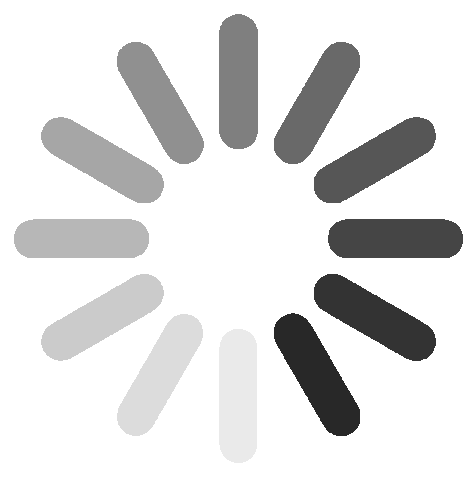

In [11]:
# Note: inside Colab, for the datamap to work
# it is required that inline_data=True
plot = datamapplot.create_interactive_plot(
    cord19_data_map,
    cord19_label_layers[0],
    cord19_label_layers[1],
    cord19_label_layers[2],
    cord19_label_layers[3],
    cord19_label_layers[4],
    cord19_label_layers[5],
    hover_text=cord19_hover_text,
    initial_zoom_fraction=0.99,
    title="CORD-19 Data Map",
    sub_title="A data map of papers relating to COVID-19 and SARS-CoV-2",
    font_family="Cinzel",
    logo="https://allenai.org/newsletters/archive/2023-03-newsletter_files/927c3ca8-6c75-862c-ee5d-81703ef10a8d.png",
    logo_width=128,
    marker_size_array=cord19_marker_size_array,
    cmap=colorcet.cm.CET_C2s,
    noise_color="#aaaaaa66",
    cluster_boundary_polygons=True,
    enable_search=True,
    inline_data=True,
    offline_data_prefix="cord_gallery",
)
plot.save("cord19.html")
plot

In [12]:
elapsed = time.time() - start
print(f"Total runtime: {timedelta(seconds=elapsed)}")

Total runtime: 0:02:44.422452


## Export datamap

The above code (**plot.save()**) saved the datamap as a single HTML file named, cord19.html. The entire datamap web-app is contained in that single file. Download that single 40MB file, attach it to an email, and the recipient will be able to load that file into a web browser while in airplane mode (no network) and it will still work. Also handy if you have to hand your datamap off to be read from inside an air-gapped facility.

In [13]:
from google.colab import files

# Download the newly saved datamap to localhost
files.download('cord19.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>